In [1]:
import matplotlib.pyplot as plt
from keras.applications import VGG16,imagenet_utils
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import load_img
from keras.models import Model
from keras.layers import Dense
import numpy as np
from IPython.display import Image,display
import glob
import os


Using TensorFlow backend.


In [2]:
inputShape = (224, 224)
preprocess = imagenet_utils.preprocess_input

def get_features(model,file):
    image = load_img(file,target_size=inputShape)
    image = img_to_array(image)
    image = np.expand_dims(image,axis=0)

    image = preprocess(image)
    feature = model.predict(image)
    return np.squeeze(feature)

def check_images(file):
    try:
        image = load_img(file,target_size=inputShape)
    except:
        print(f'Removing {file}')
        os.remove(file)
        
def gen_feature_matrix(model,image_list):
    feature_matrix = []
    for file in image_list:
        feature_matrix.append(get_features(model,file))

    return np.array(feature_matrix)
        
def find_match(file,feature_matrix,image_list):
    img_feature = get_features(feature_model,file)
    L2 = np.sum((feature_matrix-img_feature)**2,axis=1)
    match = np.argmin(L2)

    print(f'distance: {np.sqrt(np.min(L2))}')
    display(Image(filename=file,width=inputShape[0],height=inputShape[1]))
    display(Image(filename=image_list[match],width=inputShape[0],height=inputShape[1]))
    
def gen_pairs(N,feature_matrix,images):
    img_index = np.random.randint(len(images),size=N)
    for i in img_index:
        img_feature = feature_matrix[i,:]
        L2 = np.sum((feature_matrix-img_feature)**2,axis=1)
        match = np.argsort(L2)[1]

        print(f'{match} distance: {np.sqrt(L2[match])}')
        display(Image(filename=images[i],width=inputShape[0],height=inputShape[1]))
        display(Image(filename=images[match],width=inputShape[0],height=inputShape[1]))

In [5]:
model = VGG16(weights='imagenet')

FC6_linear = Model(inputs = model.input,
                   output = Dense(4096, activation=None, name='FC6')(model.get_layer('fc1').input))
FC7_linear = Model(inputs = model.input,
                   output = Dense(4096, activation=None, name='FC7')(model.get_layer('fc2').input))
FC8_linear = Model(inputs = model.input,
                   output = Dense(1000, activation=None, name='FC8')(model.get_layer('predictions').input))

/Users/nsteins/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("FC...)`
  after removing the cwd from sys.path.
/Users/nsteins/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("FC...)`
  
/Users/nsteins/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("FC...)`
  


In [3]:
couch_images = glob.glob('./Data/OpenImages/couch/*.jpg')
light_images = glob.glob('./Data/OpenImages/light_fixture/*.jpg')


In [11]:
%time
FC6_linear_couch = gen_feature_matrix(FC6_linear,couch_images)

CPU times: user 1 µs, sys: 0 ns, total: 1 µs
Wall time: 5.01 µs


/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 393216 bytes but only got 0. Skipping tag 3
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 36962304 bytes but only got 0. Skipping tag 5
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 37486592 bytes but only got 0. Skipping tag 5
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 131072 bytes but only got 0. Skipping tag 3
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin

In [12]:
%time
FC7_linear_couch = gen_feature_matrix(FC7_linear,couch_images)

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 8.11 µs


/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 393216 bytes but only got 0. Skipping tag 3
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 36962304 bytes but only got 0. Skipping tag 5
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 37486592 bytes but only got 0. Skipping tag 5
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 131072 bytes but only got 0. Skipping tag 3
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin

In [13]:
%time
FC8_linear_couch = gen_feature_matrix(FC8_linear,couch_images)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 4.77 µs


/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 393216 bytes but only got 0. Skipping tag 3
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 36962304 bytes but only got 0. Skipping tag 5
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 37486592 bytes but only got 0. Skipping tag 5
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 131072 bytes but only got 0. Skipping tag 3
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin

In [14]:
%time
FC6_linear_light = gen_feature_matrix(FC6_linear,light_images)

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 4.77 µs


/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 3263561744 bytes but only got 0. Skipping tag 8
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 4568514560 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2284978176 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 19600506880 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/Ti

/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 32 bytes but only got 5. Skipping tag 272
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 65536 bytes but only got 0. Skipping tag 51
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 31197188 bytes but only got 0. Skipping tag 1029
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:709: UserWarning: Corrupt EXIF data.  Expecting to read 12 bytes but only got 3. 
  warnings.warn(str(msg))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:709: UserWarning: Corrupt EXIF data.  Expect

In [15]:
%time
FC7_linear_light = gen_feature_matrix(FC7_linear,light_images)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 21 µs


/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 3263561744 bytes but only got 0. Skipping tag 8
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 4568514560 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2284978176 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 19600506880 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/Ti

/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 32 bytes but only got 5. Skipping tag 272
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 65536 bytes but only got 0. Skipping tag 51
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 31197188 bytes but only got 0. Skipping tag 1029
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:709: UserWarning: Corrupt EXIF data.  Expecting to read 12 bytes but only got 3. 
  warnings.warn(str(msg))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:709: UserWarning: Corrupt EXIF data.  Expect

In [16]:
%time
FC8_linear_light = gen_feature_matrix(FC8_linear,light_images)

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 5.01 µs


/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 3263561744 bytes but only got 0. Skipping tag 8
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 4568514560 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2284978176 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 19600506880 bytes but only got 0. Skipping tag 0
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/Ti

/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 32 bytes but only got 5. Skipping tag 272
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 65536 bytes but only got 0. Skipping tag 51
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 31197188 bytes but only got 0. Skipping tag 1029
  "Skipping tag %s" % (size, len(data), tag))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:709: UserWarning: Corrupt EXIF data.  Expecting to read 12 bytes but only got 3. 
  warnings.warn(str(msg))
/Users/nsteins/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:709: UserWarning: Corrupt EXIF data.  Expect

KeyboardInterrupt: 

In [47]:
import pickle
pickle.dump(FC6_linear_couch,open('Data/feature_matrix/FC6_linear_couch.p','wb'))
pickle.dump(FC7_linear_couch,open('Data/feature_matrix/FC7_linear_couch.p','wb'))
pickle.dump(FC8_linear_couch,open('Data/feature_matrix/FC8_linear_couch.p','wb'))
pickle.dump(FC6_linear_light,open('Data/feature_matrix/FC6_linear_light.p','wb'))
pickle.dump(FC7_linear_light,open('Data/feature_matrix/FC7_linear_light.p','wb'))

154 distance: 676.1256713867188


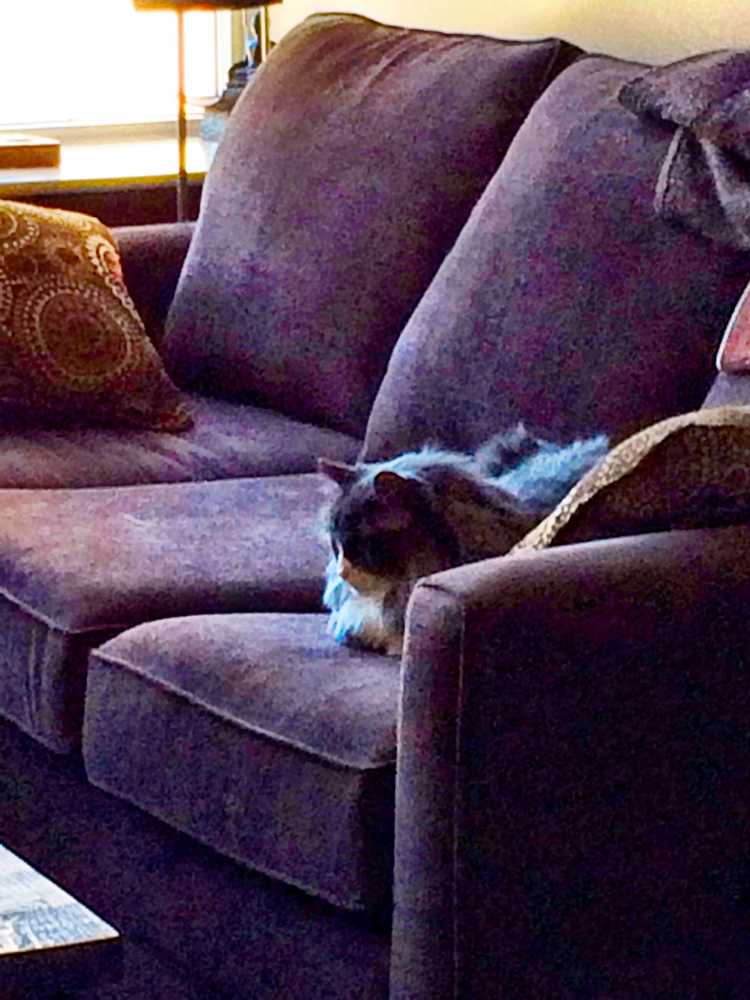

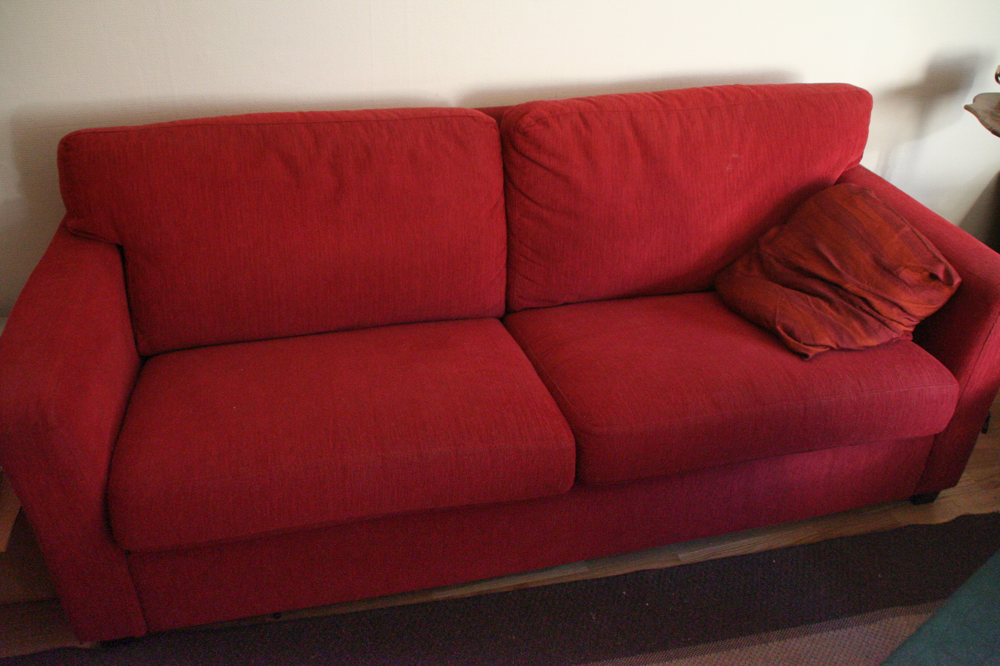

562 distance: 480.56689453125


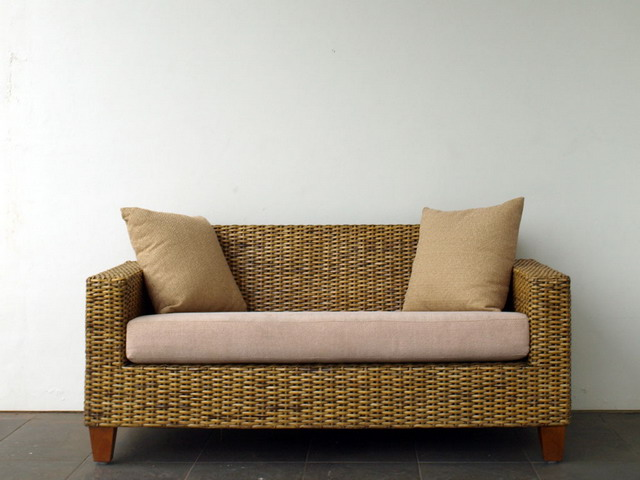

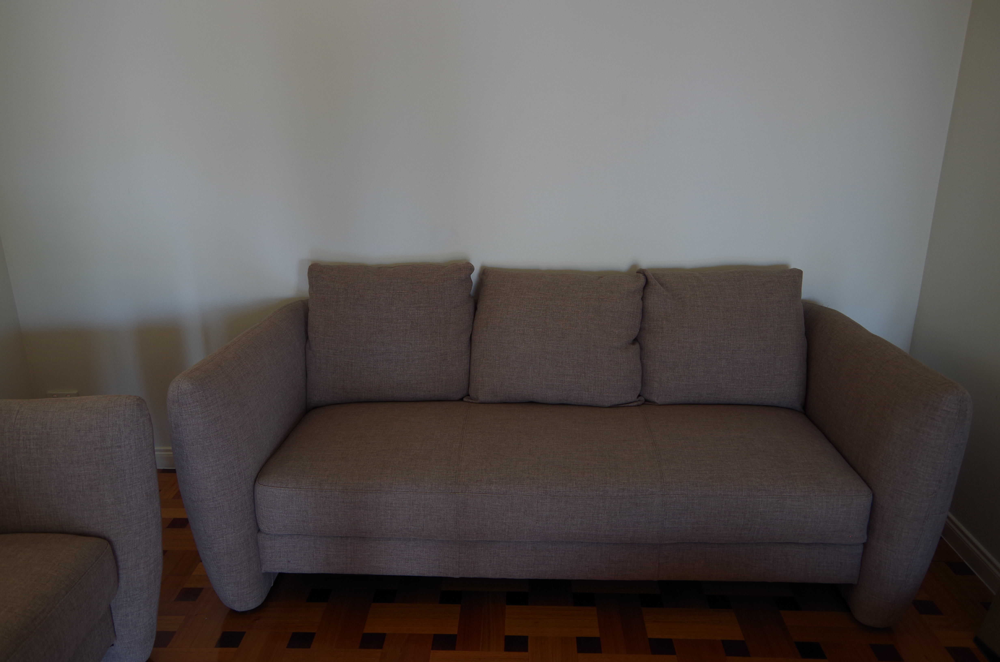

200 distance: 615.28759765625


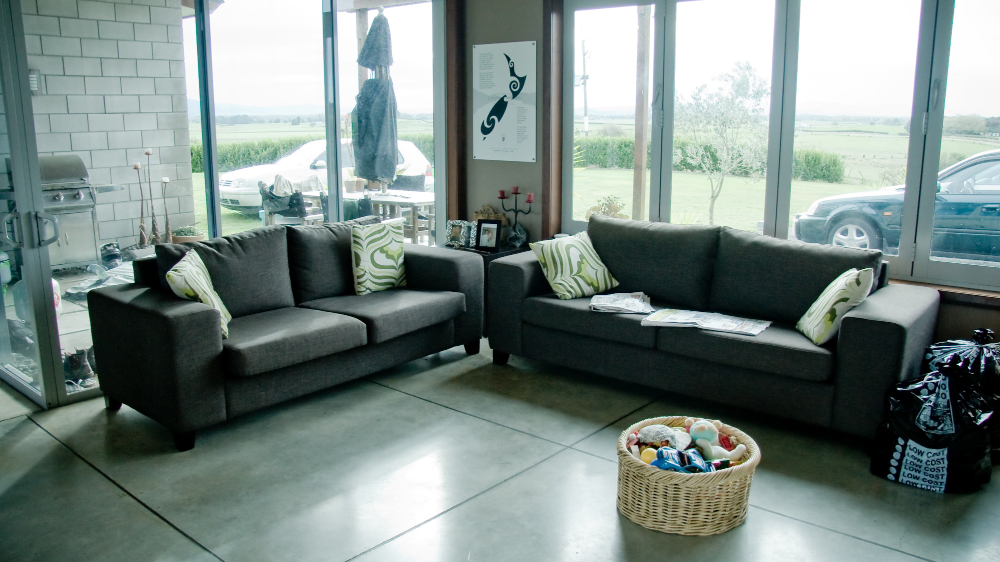

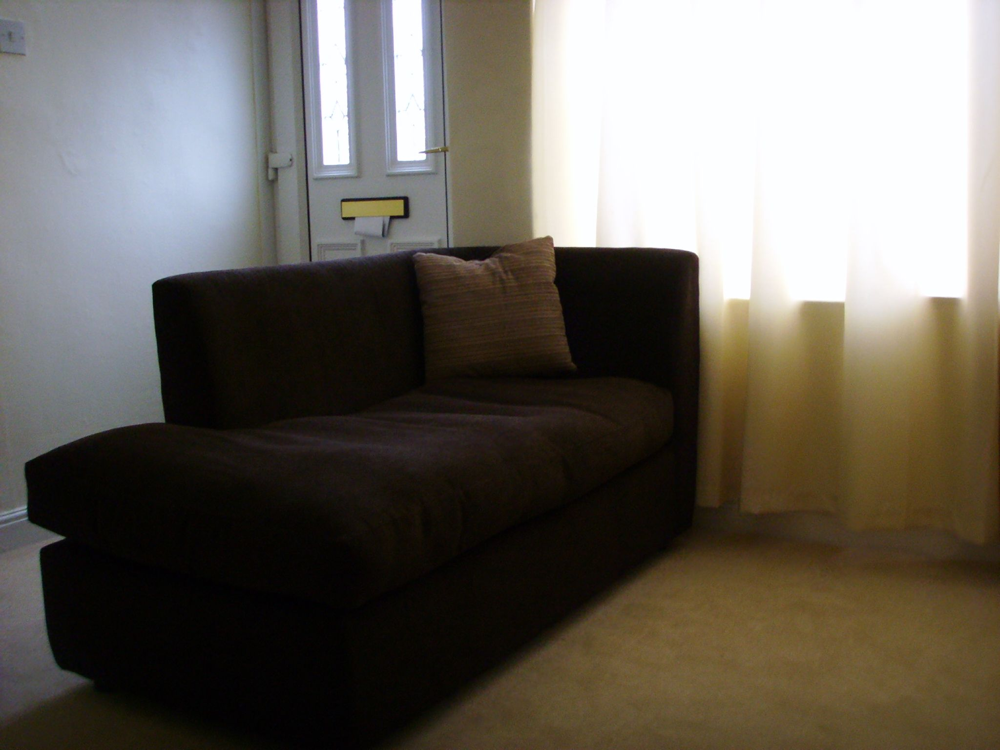

490 distance: 556.0634765625


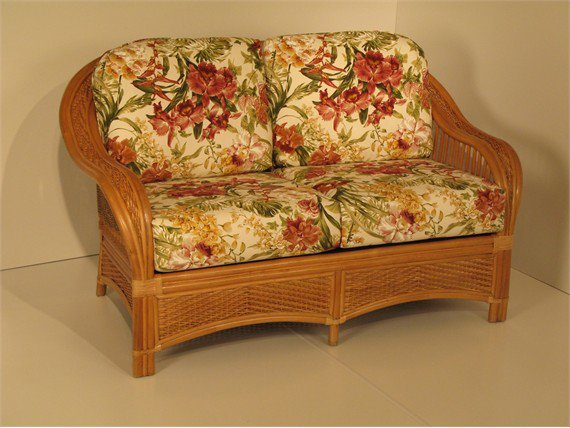

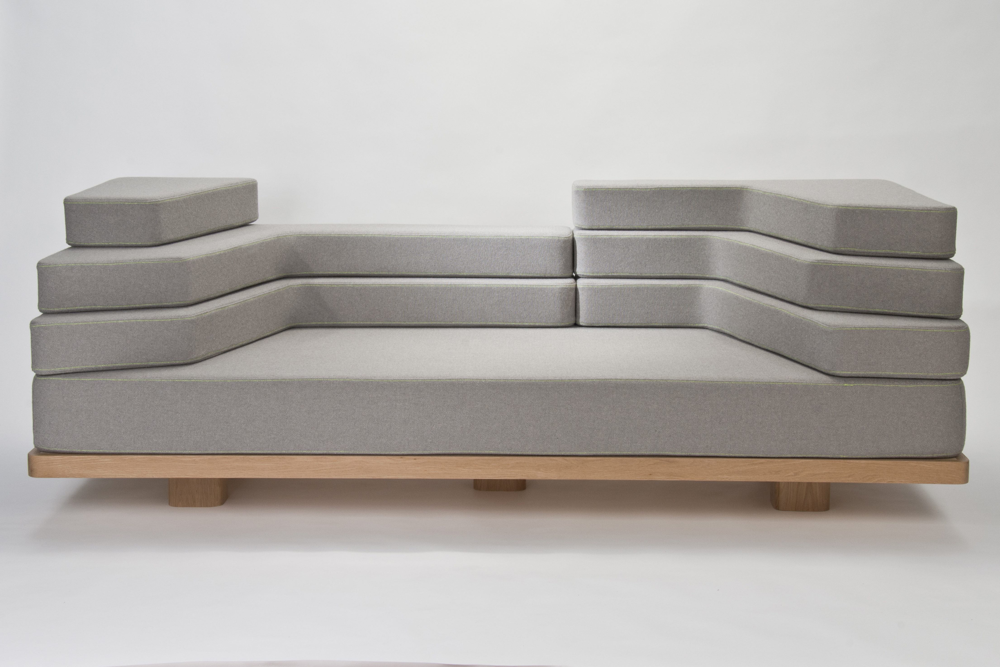

328 distance: 409.9837951660156


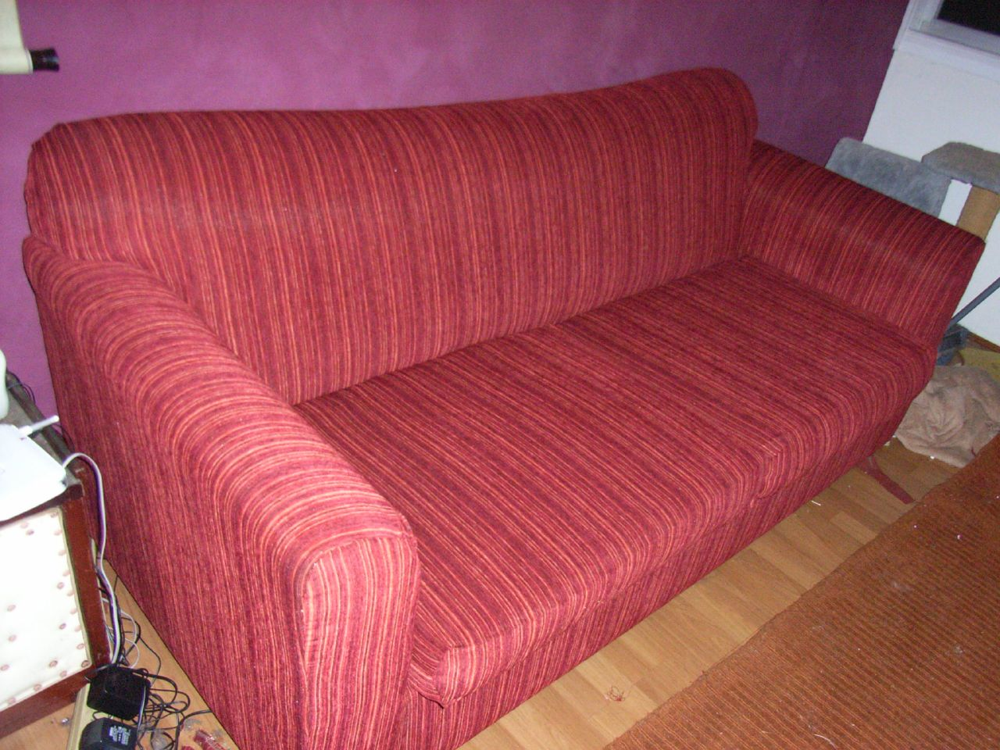

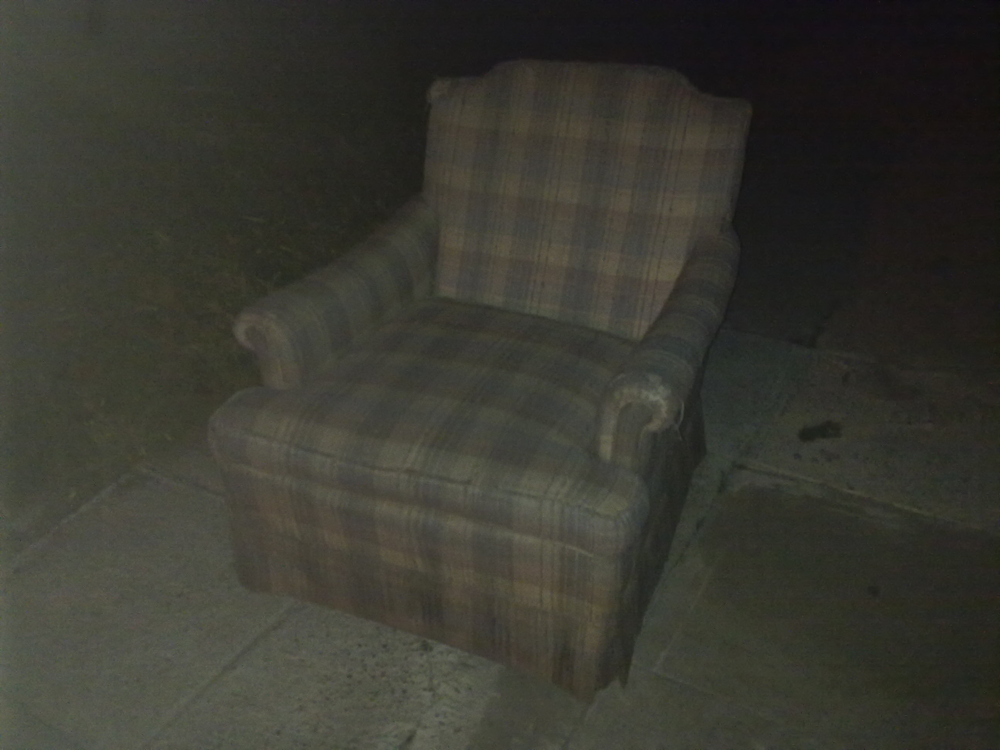

In [46]:
gen_pairs(5,FC6_relu_couch,couch_images)

In [40]:
FC6_relu_couch = np.where(FC6_linear_couch>0,FC6_linear_couch,0)

In [4]:
import pickle
FC6_linear_couch = pickle.load(open('./Data/feature_matrix/FC6_linear_couch.p','rb'))
FC7_linear_couch = pickle.load(open('./Data/feature_matrix/FC7_linear_couch.p','rb'))
FC8_linear_couch = pickle.load(open('./Data/feature_matrix/FC8_linear_couch.p','rb'))

In [5]:
from sklearn.manifold import TSNE
tsne = TSNE()
fc6_couch_embed = tsne.fit_transform(FC6_linear_couch)
fc7_couch_embed = tsne.fit_transform(FC7_linear_couch)
fc8_couch_embed = tsne.fit_transform(FC8_linear_couch)

In [6]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

# Plots an image at each x and y location. 
def plotImage(x, y, image, ax):
    im = OffsetImage(load_img(image,target_size=inputShape), zoom=0.15)
    ab = AnnotationBbox(im, (x, y), xycoords='data', frameon=False)
    ax.add_artist(ab)

# Create figure
def plot_tsne(embed,images,file):
    fig = plt.figure(figsize=(20,20),dpi=300)
    ax = fig.add_subplot(111)

    for i in range(200):
        plotImage(embed[i,0],embed[i,1],images[i],ax)

    ax.set_ylim(np.min(embed[:,1]),np.max(embed[:,1]))
    ax.set_xlim(np.min(embed[:,0]),np.max(embed[:,0]))

    plt.savefig(file)

In [7]:
plot_tsne(fc6_couch_embed,couch_images,'output/fc6_linear_couch_tsne.png')

In [8]:
plot_tsne(fc7_couch_embed,couch_images,'output/fc7_linear_couch_tsne.png')

In [9]:
plot_tsne(fc8_couch_embed,couch_images,'output/fc8_linear_couch_tsne.png')